## Initial Setup

In [ ]:
import sys
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
%matplotlib inline
import math

#### Import dataset

In [ ]:

if os.path.isfile('./dataset.jpeg'):
  print('Image dataset already downloaded.')
else:
  !wget "https://thor.robots.ox.ac.uk/datasets/penguins/BAILa.tgz" -O dataset.tgz

--2024-04-02 00:16:50--  https://thor.robots.ox.ac.uk/datasets/penguins/BAILa.tgz
Resolving thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)... 129.67.95.98
Connecting to thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)|129.67.95.98|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1778662965 (1.7G) [application/octet-stream]
Saving to: ‘dataset.tgz’

dataset.tgz         100%[===================>]   1.66G   171MB/s    in 12s     

2024-04-02 00:17:02 (145 MB/s) - ‘dataset.tgz’ saved [1778662965/1778662965]



In [ ]:
if os.path.exists('./data'):
  print('data already extracted')
else:
  !mkdir -p ./data
  !tar -xzf dataset.tgz -C ./data

## Helper Functions

In [ ]:
# Function to automatically adjust  display of pictures
def show_images(images):
  n_images = len(images)

  # Calculate the grid size: square root of the number of images
  # Adjust rows and columns based on the number of images
  n_cols = int(math.ceil(np.sqrt(n_images)))
  n_rows = int(math.ceil(n_images / n_cols))

  # Adjust the figure size as needed
  plt.figure(figsize=(20, 10))

  # Dynamically adjust the grid size
  for i, image in enumerate(images):
    plt.subplot(n_rows, n_cols, i + 1)
    plt.imshow(image)
    plt.title(f'Image {i+1}')
    plt.axis('off')

  plt.tight_layout()
  plt.show()

In [ ]:
# Fucntion to  display results and originals side by side
def show_images_side_by_side(list1, list2):
    assert len(list1) == len(list2), "The lists must have the same length."

    n_images = len(list1)

    # We want 2 images per row, so we calculate the total number of rows needed.
    # Since we are displaying images in pairs side by side, the number of rows is the same as the number of images in each list.
    n_rows = n_images  # One row per pair
    n_cols = 2  # Two images per row (one from each list)

    # Adjust the figure size as needed
    plt.figure(figsize=(10, 5 * n_rows))

    for i in range(n_images):
        # Display the first image of the pair
        plt.subplot(n_rows, n_cols, 2*i + 1)
        plt.imshow(list1[i])
        plt.title(f'Pair {i+1} - Original')
        plt.axis('off')

        # Display the second image of the pair
        plt.subplot(n_rows, n_cols, 2*i + 2)
        plt.imshow(list2[i])
        plt.title(f'Pair {i+1} - Modified')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

## Choose the batch of images to process and show them

In [ ]:
def choose_images(start=0, end=10):
  image_directory = '/content/data/BAILa'

  # Grab array of file names from image directory
  image_files = [f for f in os.listdir(image_directory)]

  opencv_images = []

  # loop over all files in desired range
  for image_file in image_files[start:end]:

      # Grab image path and ipen it
      image_path = os.path.join(image_directory, image_file)
      print(image_path)  # Check the path
      image = cv2.imread(image_path)
      if image is None:
          print(f"Failed to load image: {image_path}")
      else:
          # If the image loads, convert and add it to the list
          image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
          opencv_images.append(image_rgb)
  return opencv_images


In [ ]:
opencv_images = choose_images(start=100, end=150) #110-118 is a good representation

/content/data/BAILa/BAILa2014a_003636.JPG
/content/data/BAILa/BAILa2014a_001465.JPG
/content/data/BAILa/BAILa2014a_004174.JPG
/content/data/BAILa/BAILa2014a_003380.JPG
/content/data/BAILa/BAILa2014a_000542.JPG
/content/data/BAILa/BAILa2014a_001526.JPG
/content/data/BAILa/BAILa2014a_001976.JPG
/content/data/BAILa/BAILa2014a_001952.JPG
/content/data/BAILa/BAILa2014a_003071.JPG
/content/data/BAILa/BAILa2014a_004338.JPG
/content/data/BAILa/BAILa2014a_002497.JPG
/content/data/BAILa/BAILa2014a_001245.JPG
/content/data/BAILa/BAILa2014a_001650.JPG
/content/data/BAILa/BAILa2014a_004321.JPG
/content/data/BAILa/BAILa2014a_004079.JPG
/content/data/BAILa/BAILa2014a_003329.JPG
/content/data/BAILa/BAILa2014a_004145.JPG
/content/data/BAILa/BAILa2014a_001378.JPG
/content/data/BAILa/BAILa2014a_000337.JPG
/content/data/BAILa/BAILa2014a_003472.JPG
/content/data/BAILa/BAILa2014a_002220.JPG
/content/data/BAILa/BAILa2014a_000140.JPG
/content/data/BAILa/BAILa2014a_002938.JPG
/content/data/BAILa/BAILa2014a_001

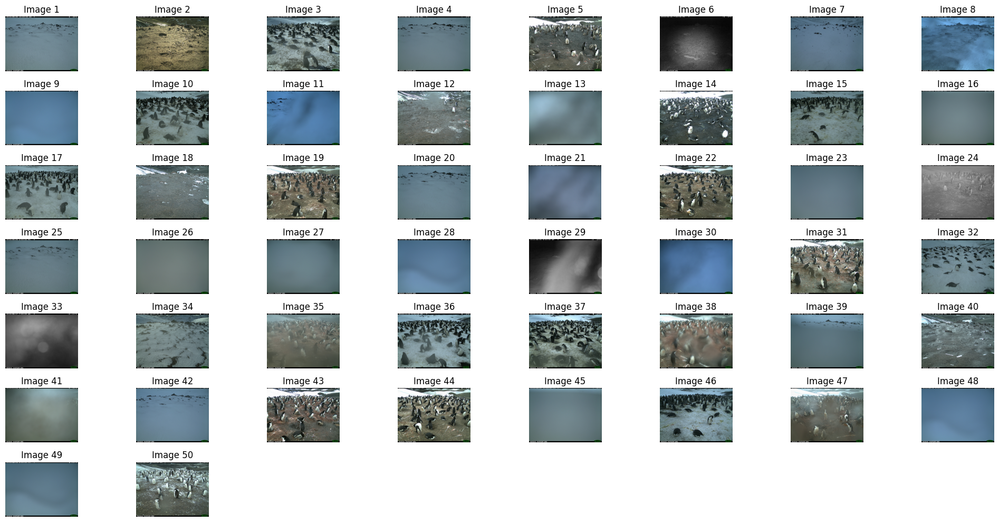

In [ ]:
show_images(opencv_images)

Components are rock, snow/ice, and penguins.


## Penguins

In [ ]:
import torch
from torchvision import models, transforms
from PIL import Image, ImageOps

"""
Function to run image through the penguin segmentation
Documentation used to help:
- https://pytorch.org/vision/main/models/generated/torchvision.models.segmentation.deeplabv3_resnet101.html
-
"""
def deeplab_resnet101(images):
  # Load a pre-trained DeepLabv3 model (with default weights)
  model = models.segmentation.deeplabv3_resnet101(weights='COCO_WITH_VOC_LABELS_V1')
  model.eval()

  # Define the standard ImageNet transforms
  # reference: https://pytorch.org/hub/pytorch_vision_deeplabv3_resnet101/
  preprocess = transforms.Compose([
      transforms.ToTensor(),
      transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
  ])

  # Move the input and model to GPU for speed if available
  if torch.cuda.is_available():
      model.to('cuda')


  res_images = []
  masks = []

  for i, image in enumerate(images):
    # Must use PIL images, so need to convert
    # Can do so as shown

    image_copy = image.copy()
    # Convert to YCrCb color space
    ycrcb_image = cv2.cvtColor(image_copy, cv2.COLOR_BGR2YCrCb)

    # Equalize the histogram of the Y channel
    ycrcb_image[:, :, 0] = cv2.equalizeHist(ycrcb_image[:, :, 0])

    # Convert back to RGB (BGR in OpenCV) color space
    equalized_image = cv2.cvtColor(ycrcb_image, cv2.COLOR_YCrCb2RGB)

    # Must be in RGB format, which they are.
    # Convert to PIL image
    pil_image = Image.fromarray(equalized_image)

    input_tensor = preprocess(pil_image)
    input_batch = input_tensor.unsqueeze(0)  # Create a mini-batch as expected by the model
    if torch.cuda.is_available():
      input_batch = input_batch.to('cuda')

    with torch.no_grad():
      output = model(input_batch)['out'][0]

    # Output is pixel values assigned to a class
    output_predictions = output.argmax(0)

    # Class index for birds. Classes found here: https://github.com/pytorch/vision/blob/2c4665ffbb64f03f5d18016d3398af4ac4da5f03/torchvision/prototype/datasets/_builtin/voc.categories#L4
    bird_class_index = 3

    # Generate a binary mask for the penguin (bird) class
    penguin_mask = (output_predictions == bird_class_index)

    # Convert the mask to a NumPy array - for visualization
    penguin_mask_np = penguin_mask.byte().cpu().numpy()

    # Overlay the mask on the original image
    # First, convert the PIL image to a NumPy array
    image_np = np.array(pil_image)

    # Copy the original image to not modify it
    overlay_image = image_np.copy()

    # Define a color for the overlay [R, G, B]
    overlay_color = [255, 165, 0]  # Orange

    # Apply the color to pixels in the overlay image where the mask is true
    overlay_image[penguin_mask_np == 1] = overlay_color

    res_images.append(overlay_image)
    masks.append(penguin_mask_np)

  return res_images, masks

Downloading: "https://download.pytorch.org/models/deeplabv3_resnet101_coco-586e9e4e.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet101_coco-586e9e4e.pth
100%|██████████| 233M/233M [00:01<00:00, 142MB/s]


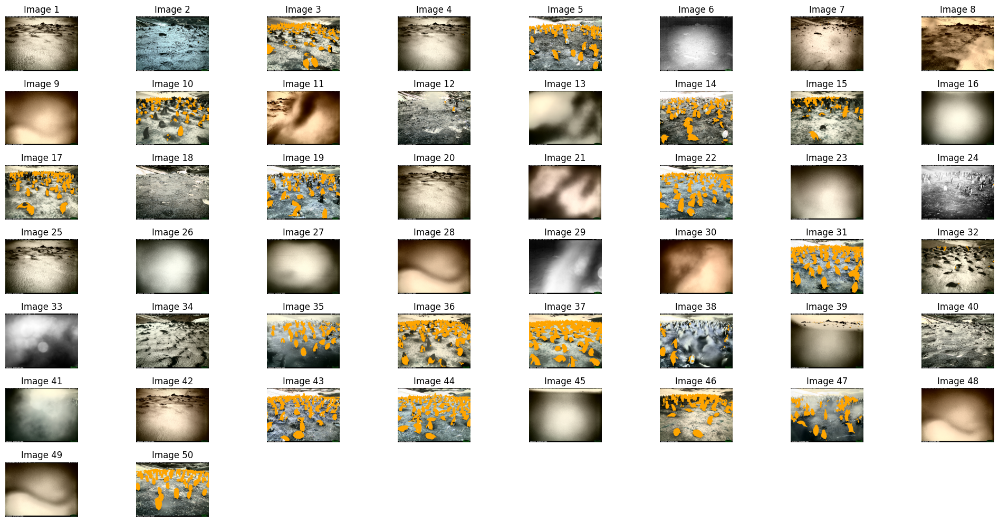

In [ ]:
# Run the segmentation of penguins on all the images and show it
penguins_res, penguin_masks = deeplab_resnet101(opencv_images)
show_images(penguins_res)

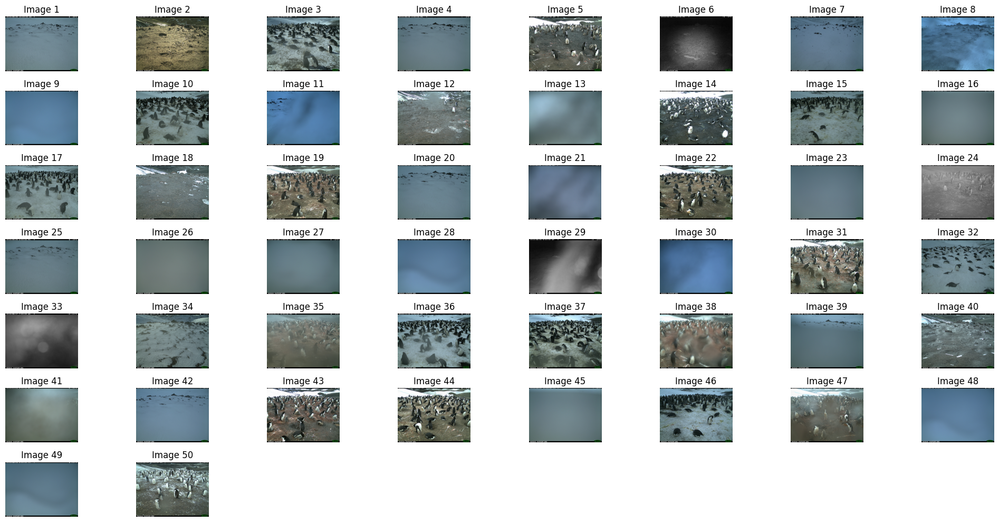

In [ ]:
# Show original images for regerence
show_images(opencv_images)

## Rock and Snow/Ice

- idea 1: convert to grayscale, and take the average pixel intensity as thresh
  - Pixels < thresh = rock, pixels > thresh = snow

- idea 2: use adapative thresholding to account for variation in local neighborhoods

### Idea 1

In [ ]:
def mean_thresh(images, penguin_masks):
  res = []
  masks = []

  for image, p_mask in zip(images, penguin_masks):

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Initial Idea: mean ground pixel value (sensitive to outliers)
    # mean = np.mean(gray[~p_mask])

    # initialize empty image
    new_image = np.zeros_like(image)

    # Define colors for replacement (in RGB format)
    rocks = [0, 0, 0]  # black
    snow = [0, 0, 255]  # Blue


    # Create a mask of where the grayscale image's intensity is below the mean
    mask_below_mean = gray < 112

    # Apply colors based on the mask
    new_image[mask_below_mean] = rocks
    new_image[~mask_below_mean] = snow

    res.append(new_image)
    masks.append(mask_below_mean)

  return res, masks

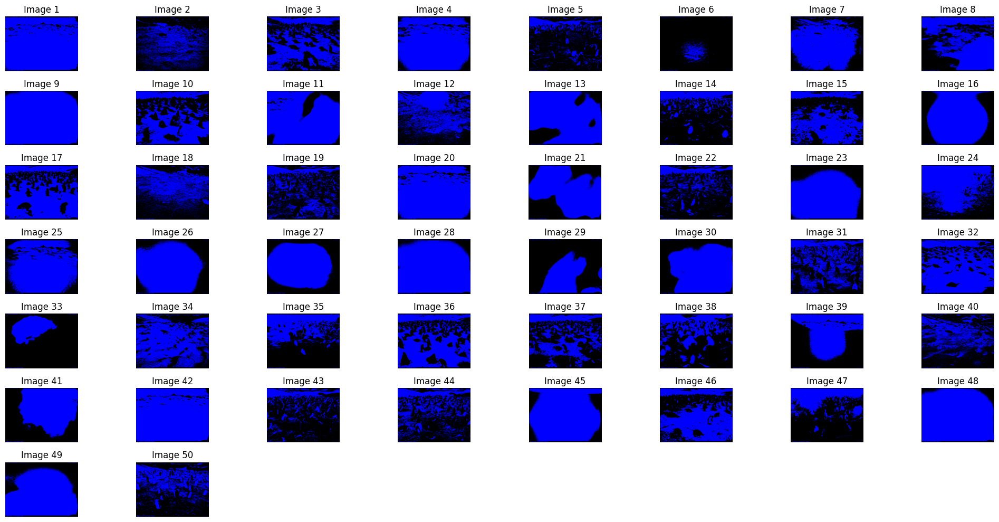

In [ ]:
mean_thresh_res, mean_thresh_masks = mean_thresh(opencv_images, penguin_masks)

show_images(mean_thresh_res)

### Idea 2 (not used)

In [ ]:
def adapt_thresh(images):
  res = []
  masks = []

  for i, image in enumerate(images):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    bw_mask = cv2.adaptiveThreshold(gray, maxValue=255,
                               adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                               thresholdType=cv2.THRESH_BINARY_INV,
                               blockSize=11, C=-10)

    # These colors are in BGR format
    snow = [0, 0, 255]
    rocks = [0, 0, 0]

    # Create a copy of the original image to modify
    copy = image.copy()

    # Set pixels in modified image based on the B&W mask
    copy[bw_mask == 255] = snow  # Set pixels to green where the mask is white
    copy[bw_mask == 0] = rocks    # Set pixels to red where the mask is black

    res.append(copy)
    masks.append(bw_mask)

  return res, masks


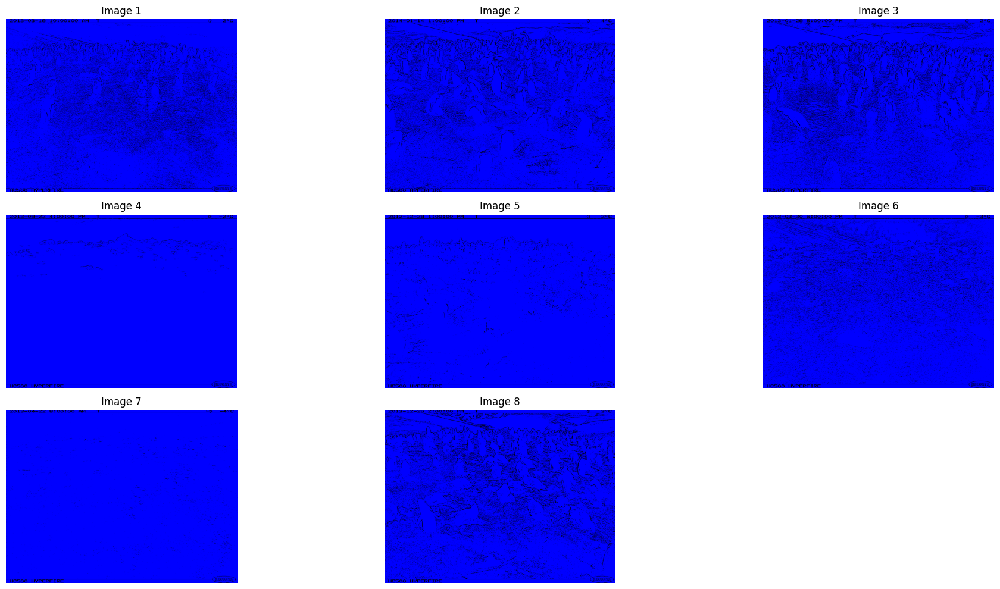

In [ ]:
adapt_thresh_res, black_white_masks = adapt_thresh(opencv_images)

show_images(adapt_thresh_res)

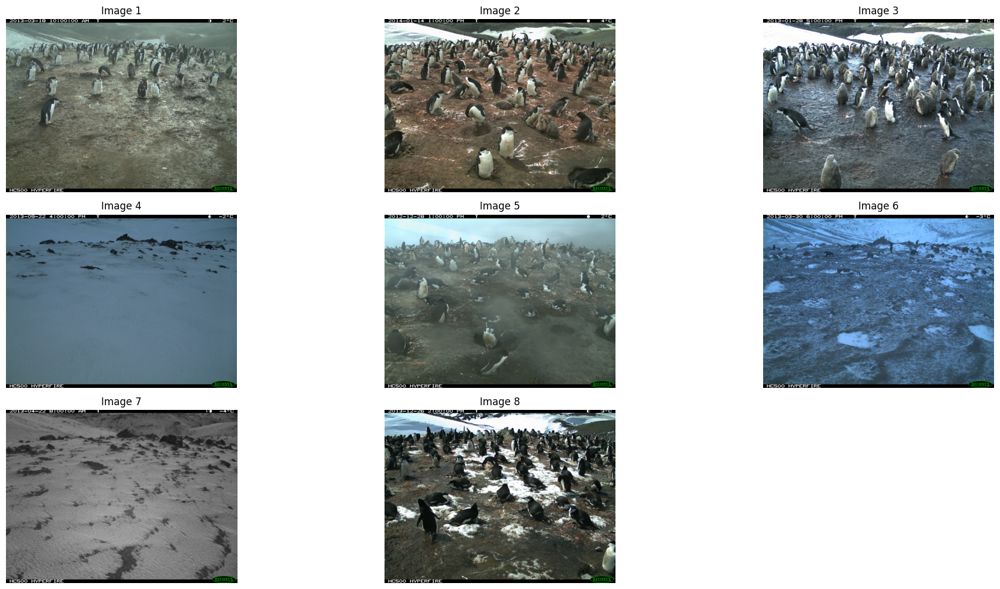

In [ ]:
show_images(opencv_images)

### Idea 3, CLACHE thresholding (Not Used)

In [ ]:
def mean_thresh_with_clahe(images):
    res = []
    masks = []

    # Initialize CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

    for i, image in enumerate(images):
        # Convert to grayscale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply CLAHE to the grayscale image
        clahe_image = clahe.apply(gray)

        # Calculate mean of the CLAHE-applied grayscale image
        mean = np.mean(clahe_image)

        # Initialize empty image for output
        new_image = np.zeros_like(image)

        # Define colors for replacement
        rocks = [0, 0, 0]  # Black for rocks
        snow = [0, 0, 255]  # Blue for snow

        # Create mask where image intensity is below the mean
        mask_below_mean = clahe_image < mean

        # Apply colors based on the mask
        new_image[mask_below_mean] = rocks
        new_image[~mask_below_mean] = snow

        res.append(new_image)
        masks.append(mask_below_mean)

    return res, masks

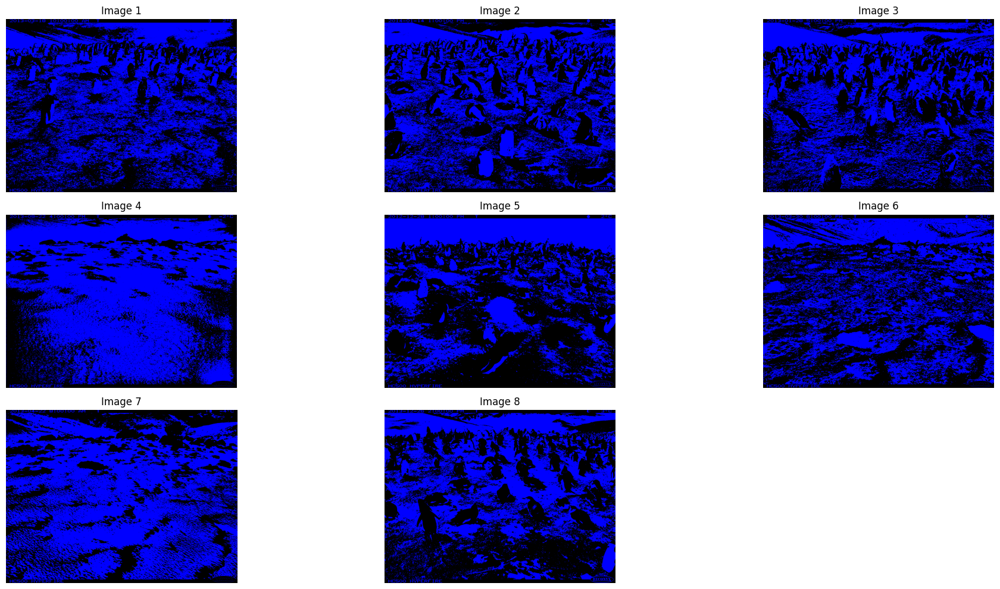

In [ ]:
mean_thresh_res, mean_thresh_masks = mean_thresh_with_clahe(opencv_images)

show_images(mean_thresh_res)

### Idea 4 - CLACHE with adaptive (Not used)

In [ ]:
def apply_clahe_and_adaptive_threshold_exclude_penguins(images, penguin_masks):
    clahe_results = []
    boolean_masks = []  # This will store the boolean masks

    # Initialize CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

    for image, penguin_mask in zip(images, penguin_masks):
        # Convert the image to grayscale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply CLAHE to the grayscale image
        clahe_image = clahe.apply(gray)

        # Prepare the image for thresholding by excluding penguins
        # Set penguin pixels in the CLAHE image to the mean intensity of non-penguin areas
        mean_intensity = np.mean(clahe_image[~penguin_mask])
        modified_image = clahe_image.copy()
        modified_image[penguin_mask] = mean_intensity

        # Generate a boolean mask from the modified image using an adaptive threshold
        # Note: Instead of directly using cv2.adaptiveThreshold, we'll compare the pixel values to generate the boolean mask
        # Calculate local threshold using adaptive method but retain as boolean mask
        adaptive_thresh_value = cv2.adaptiveThreshold(modified_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                                      cv2.THRESH_BINARY, 11, 2)
        boolean_mask = adaptive_thresh_value == 0  # True for pixels below the adaptive threshold

        # Add results to the lists
        clahe_results.append(clahe_image)
        boolean_masks.append(boolean_mask)

    return clahe_results, boolean_masks

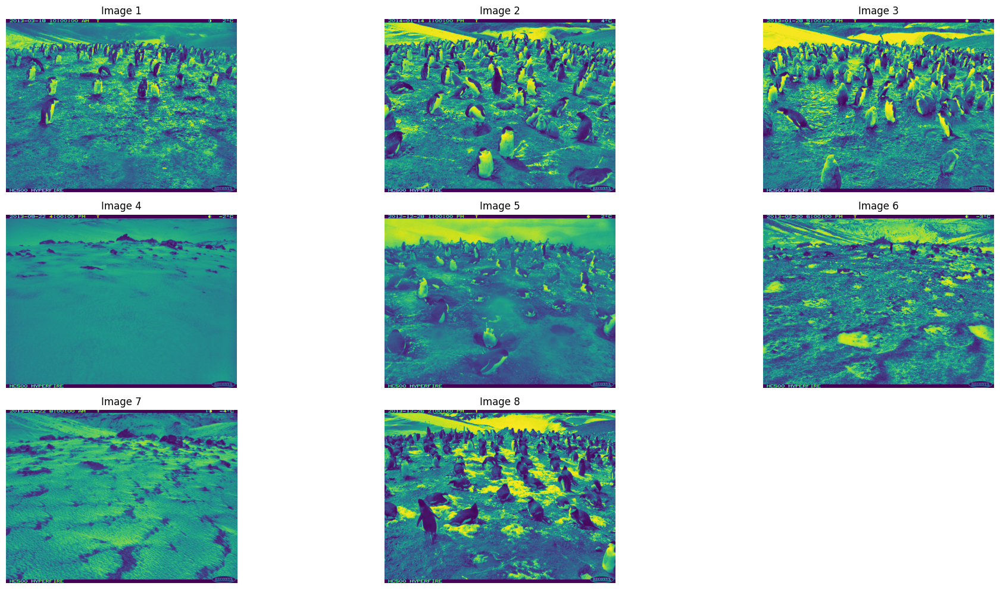

In [ ]:
res, mean_thresh_masks = apply_clahe_and_adaptive_threshold_exclude_penguins(opencv_images, penguin_masks)

show_images(res)
# print(mean_thresh_masks)

### Idea 5 Ignoring the penguin pixels (not used)


In [ ]:
def mean_thresh_with_clahe_exclude_penguins(images, penguin_masks):
    res = []
    masks = []

    # Initialize CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(4, 4))

    for image, p_mask in zip(images, penguin_masks):
        # Assuming p_mask is a binary mask where penguins are marked with 1s

        # Convert the image to grayscale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply CLAHE to the grayscale image
        clahe_image = clahe.apply(gray)

        # Mask to ignore penguin pixels: we use it to exclude penguins from influencing the threshold
        # Create an inverted mask where penguins are False and others are True
        not_penguin_mask = np.logical_not(p_mask.astype(bool))

        # Calculate the mean of the image excluding penguins
        # We use the masked array to calculate the mean only on non-penguin pixels
        masked_clahe_image = np.ma.masked_array(clahe_image, mask=~not_penguin_mask)
        mean_excluding_penguins = np.mean(masked_clahe_image)

        # Initialize an empty image for the output
        new_image = np.zeros_like(image)
        rocks = [0, 0, 0]  # Black for rocks
        snow = [0, 0, 255]  # Blue for snow

        # Create a mask based on the adjusted mean
        # Note: We apply the mask only where not_penguin_mask is True to exclude penguin areas
        mask_below_mean = np.zeros_like(clahe_image, dtype=bool)
        mask_below_mean[not_penguin_mask] = clahe_image[not_penguin_mask] < mean_excluding_penguins

        # Apply colors based on the mask, excluding penguins
        new_image[mask_below_mean] = rocks
        new_image[~mask_below_mean] = snow
        # Since we're directly using mask_below_mean which already excludes penguins,
        # we don't need to explicitly set penguin areas here unless you want to color them differently

        res.append(new_image)
        masks.append(mask_below_mean)

    return res, masks

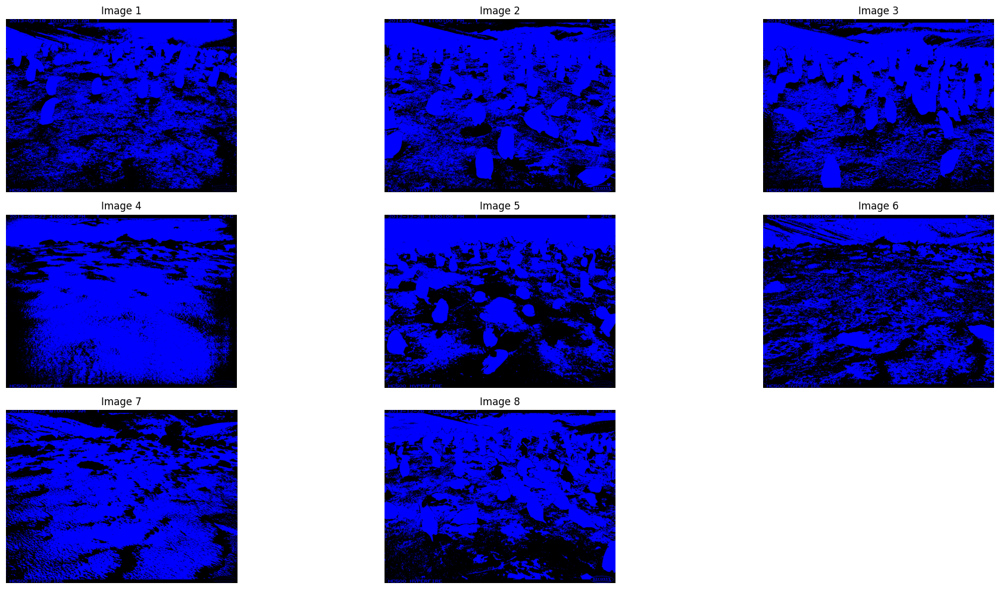

In [ ]:
mean_thresh_res, mean_thresh_masks = mean_thresh_with_clahe_exclude_penguins(opencv_images, penguin_masks)

show_images(mean_thresh_res)

## Bringing it all together

In [ ]:
# TODO: modify each function to return a tuple including a list of the output masks, and then we can layer the output masks for the best result
# There might be a better way to do this!
final = []

# Define colors for replacement (in RGB format)
rocks = [0, 0, 0]  # black
snow = [0, 0, 255]  # Blue

# Define a color for the overlay [R, G, B]
overlay_color = [255, 165, 0]  # Orange

# Loop over image, mean threashhold mask, and penguin mask all at the same time
for image, bw_mask, p_mask in zip(opencv_images, mean_thresh_masks, penguin_masks):

  copy = image.copy()

  # Set pixels in modified image based on the B&W mask
  # Apply colors based on the mask
  copy[bw_mask] = rocks
  copy[~bw_mask] = snow

  # Penguins have priority over rock/snow thresh

  # Apply the color to pixels in the overlay image where the mask is true
  copy[p_mask == 1] = overlay_color

  final.append(copy)

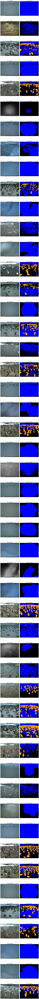

In [ ]:
show_images_side_by_side(opencv_images, final)